In [1]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix,ConfusionMatrixDisplay
from sklearn import preprocessing,metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
import pandas as pd
import matplotlib.pyplot as pl
from sklearn.ensemble import AdaBoostClassifier
import graphviz
from sklearn import tree

In [2]:
X=pd.read_csv('Cleaned_data.csv')
y=pd.read_csv('train_labels.csv')


In [3]:
X_train, X_test, y_train, y_test = train_test_split(X, y['damage_grade'], test_size = 0.3, random_state = 98)

### Logistic Regression

The Accuracy for Training Set is 58.07422431750905
The Accuracy for Test Set is 57.80048860976452
Classification report : 
               precision    recall  f1-score   support

           1       0.54      0.25      0.34      7483
           2       0.58      0.91      0.71     44326
           3       0.53      0.11      0.18     26372

    accuracy                           0.58     78181
   macro avg       0.55      0.42      0.41     78181
weighted avg       0.56      0.58      0.50     78181



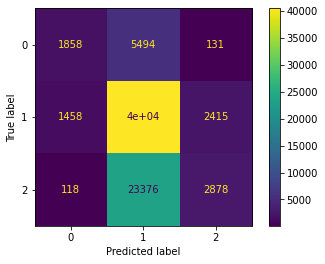

In [4]:
model=LogisticRegression(max_iter=5000)
model.fit(X_train,y_train)
train_acc = model.score(X_train, y_train)
print("The Accuracy for Training Set is {}".format(train_acc*100))
y_pred=model.predict(X_test)
test_acc = accuracy_score(y_test, y_pred)
print("The Accuracy for Test Set is {}".format(test_acc*100))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)
cm = confusion_matrix(y_test,y_pred)
ConfusionMatrixDisplay(cm).plot()

### Knn Classifier

The Accuracy for Training Set is 74.67657055147463
The Accuracy for Testing Set is 62.904030391015716
Classification report : 
               precision    recall  f1-score   support

           1       0.49      0.44      0.46      7483
           2       0.67      0.74      0.70     44326
           3       0.59      0.50      0.54     26372

    accuracy                           0.63     78181
   macro avg       0.58      0.56      0.57     78181
weighted avg       0.62      0.63      0.62     78181



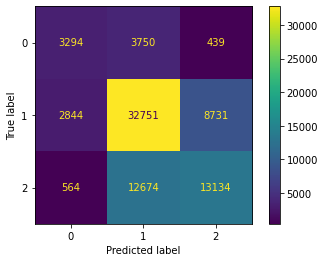

In [13]:
knn=KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train,y_train)
y_pred=knn.predict(X_test)
score=knn.score(X_train,y_train)
print("The Accuracy for Training Set is {}".format(score*100))
print("The Accuracy for Testing Set is {}".format(metrics.accuracy_score(y_test,y_pred)*100))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)
cm = confusion_matrix(y_test,y_pred)
ConfusionMatrixDisplay(cm).plot()

### Regression Tree Classifier

Testing Accuracy: 0.6929049257492229
Error Rate is: 0.3070950742507771
Classification report : 
               precision    recall  f1-score   support

           1       0.56      0.45      0.50      7483
           2       0.71      0.79      0.75     44326
           3       0.69      0.59      0.64     26372

    accuracy                           0.69     78181
   macro avg       0.65      0.61      0.63     78181
weighted avg       0.69      0.69      0.69     78181



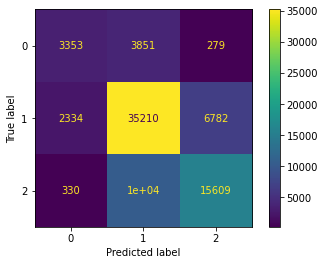

In [6]:
clf = DecisionTreeClassifier(max_depth=15)
clf = clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)
print("Testing Accuracy:",metrics.accuracy_score(y_test, y_pred))
print("Error Rate is:",1-metrics.accuracy_score(y_test, y_pred))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)
cm = confusion_matrix(y_test,y_pred)
ConfusionMatrixDisplay(cm).plot()

In [7]:
dot_data = tree.export_graphviz(clf, class_names=['1', '2','3'], out_file=None)
graph = graphviz.Source(dot_data)
graph

### Adaboost Ensembling Technique

Running with estimators:50 getting an accuracy of: 65.9495273787749
Classification report : 
               precision    recall  f1-score   support

           1       0.58      0.42      0.48      7483
           2       0.69      0.76      0.72     44326
           3       0.62      0.56      0.59     26372

    accuracy                           0.66     78181
   macro avg       0.63      0.58      0.60     78181
weighted avg       0.65      0.66      0.65     78181



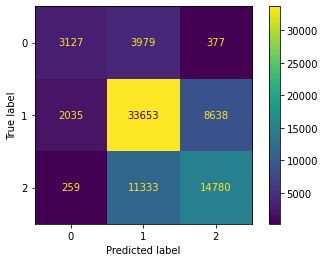

In [8]:
a=dict()
aclf = AdaBoostClassifier(n_estimators=50,base_estimator=clf)
aclf = aclf.fit(X_train,y_train)
y_pred = aclf.predict(X_test)
a[50]=metrics.accuracy_score(y_test, y_pred)*100
print('Running with estimators:'+ str(50)+" getting an accuracy of: "+str(a[50]))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)
cm = confusion_matrix(y_test,y_pred)
ConfusionMatrixDisplay(cm).plot()

###### with learning rate as default and 50 estimators accuracy is 65.9

###### with learning rate 0.02 and 700 estimators accuracy is 66.8  with learning rate 0.002 and 1000 estimators accuracy is 70.3 with learning rate 0.002 and 2000 estimators accuracy is 70


Testing Accuracy: 0.7012957112341873
Classification report : 
               precision    recall  f1-score   support

           1       0.62      0.41      0.49      7483
           2       0.71      0.82      0.76     44326
           3       0.71      0.58      0.63     26372

    accuracy                           0.70     78181
   macro avg       0.68      0.60      0.63     78181
weighted avg       0.70      0.70      0.69     78181



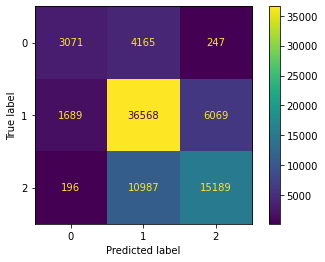

In [9]:
aclf = AdaBoostClassifier(n_estimators=1000,base_estimator=clf,learning_rate=0.002)
aclf = aclf.fit(X_train,y_train)
y_pred = aclf.predict(X_test)
print("Testing Accuracy:",metrics.accuracy_score(y_test, y_pred))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)
cm = confusion_matrix(y_test,y_pred)
ConfusionMatrixDisplay(cm).plot()

### XGBoost ensembling Technique with evaluation metric as mlogloss

C:\Users\anant\anaconda3\envs\tf_gpu\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Testing Accuracy: 0.7391309909057188
Error Rate is: 0.26086900909428123
Classification report : 
               precision    recall  f1-score   support

           1       0.67      0.51      0.58      7483
           2       0.74      0.84      0.79     44326
           3       0.75      0.63      0.69     26372

    accuracy                           0.74     78181
   macro avg       0.72      0.66      0.68     78181
weighted avg       0.74      0.74      0.73     78181



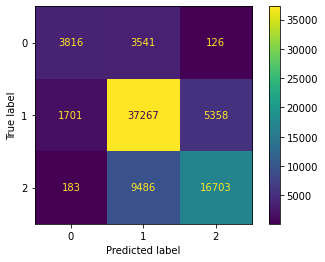

In [10]:
import xgboost as xgb
clf = xgb.XGBClassifier(
    n_estimators=2000,
    objective='multi:softmax',
    num_class=3,
    max_depth=12, 
    learning_rate=0.02, 
    subsample=0.8,
    colsample_bytree=0.4, 
    missing=-1, 
    eval_metric='mlogloss',
    nthread=40,
    tree_method='hist'
    )
clf = clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)
print("Testing Accuracy:",metrics.accuracy_score(y_test, y_pred))
print("Error Rate is:",1-metrics.accuracy_score(y_test, y_pred))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)
cm = confusion_matrix(y_test,y_pred)
ConfusionMatrixDisplay(cm).plot()

### Naive Bayes classiffier

Accuracy: 0.469
Error rate: 0.5310


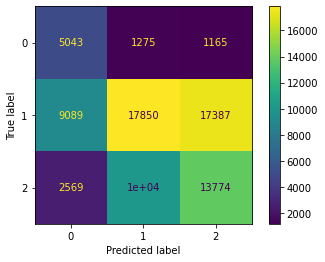

In [11]:
clf_gb = GaussianNB(priors = [0.5, 0.4,0.1])
# training
clf_gb.fit(X_train, y_train)

# testing
predict = clf_gb.predict(X_test)
accuracy_dt = accuracy_score(y_test,predict)
print('Accuracy: {:.4}\nError rate: {:.4f}'.format(accuracy_dt, 1-accuracy_dt))

cm = confusion_matrix(y_test,predict)
ConfusionMatrixDisplay(cm).plot()

#### Class priors = [0.5, 0.4,0.1] acc= 0.478    [0.3, 0.4,0.3] acc = 0.426   [0.6, 0.3,0.1] acc= 0.445 [0.4, 0.4,0.2] acc= 0.4346

In [12]:
matrix = classification_report(y_test,predict,labels=[1,2,3])
print('Classification report : \n',matrix)

Classification report : 
               precision    recall  f1-score   support

           1       0.30      0.67      0.42      7483
           2       0.61      0.40      0.49     44326
           3       0.43      0.52      0.47     26372

    accuracy                           0.47     78181
   macro avg       0.45      0.53      0.46     78181
weighted avg       0.52      0.47      0.47     78181

